In [1]:
import numpy as np
import librosa
import IPython.display as ipd
import matplotlib.pyplot as plt
from scipy.signal import fftconvolve, decimate
from scipy import interpolate
from sklearn.decomposition import PCA
import sys
import time
sys.path.append("..")
from SlidingWindow import *
from CurvatureTools import *
from Sunspot import *
%matplotlib notebook

<IPython.core.display.Javascript object>


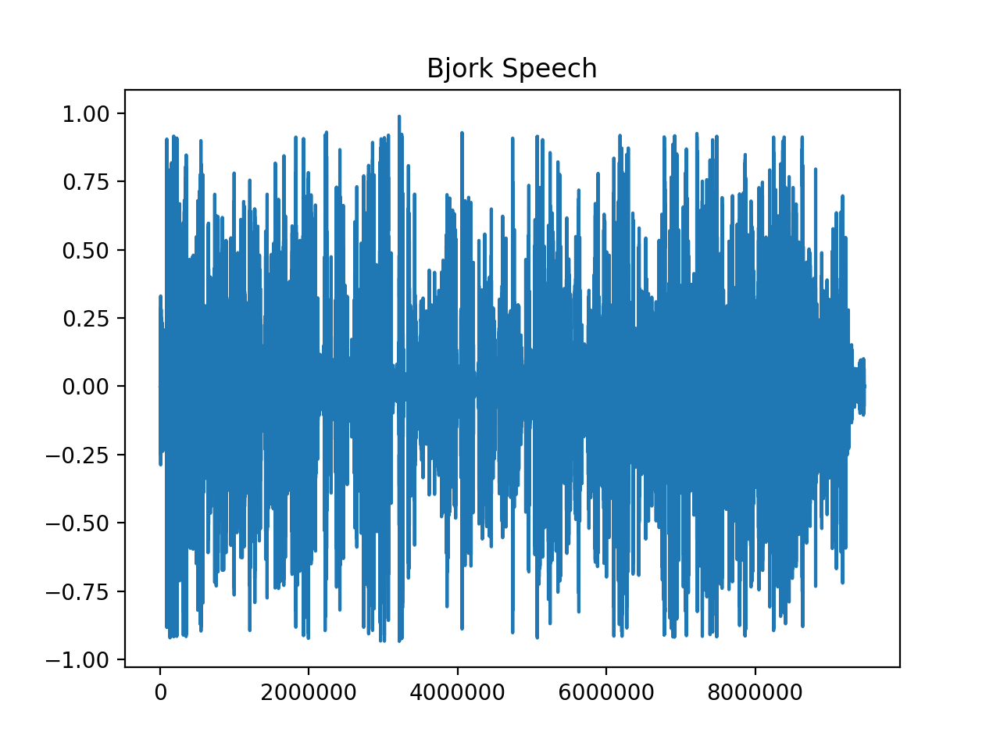

<IPython.core.display.Javascript object>


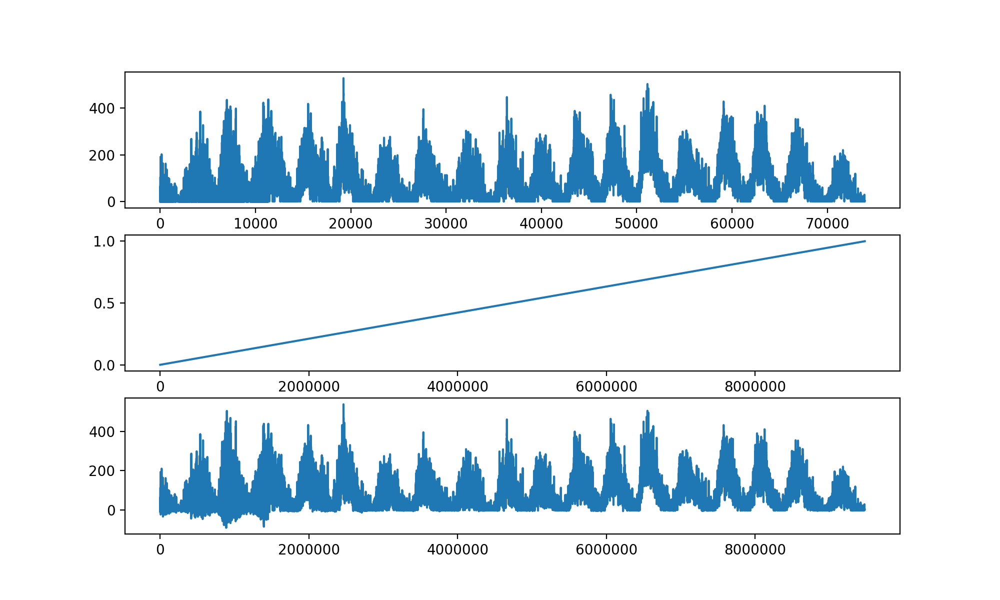

<IPython.core.display.Javascript object>


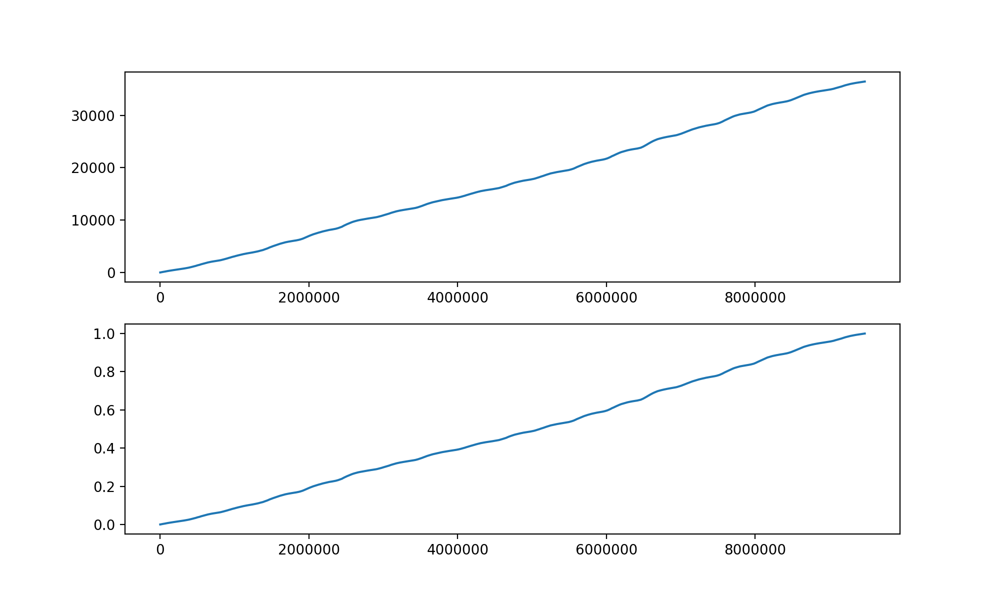

<IPython.core.display.Javascript object>


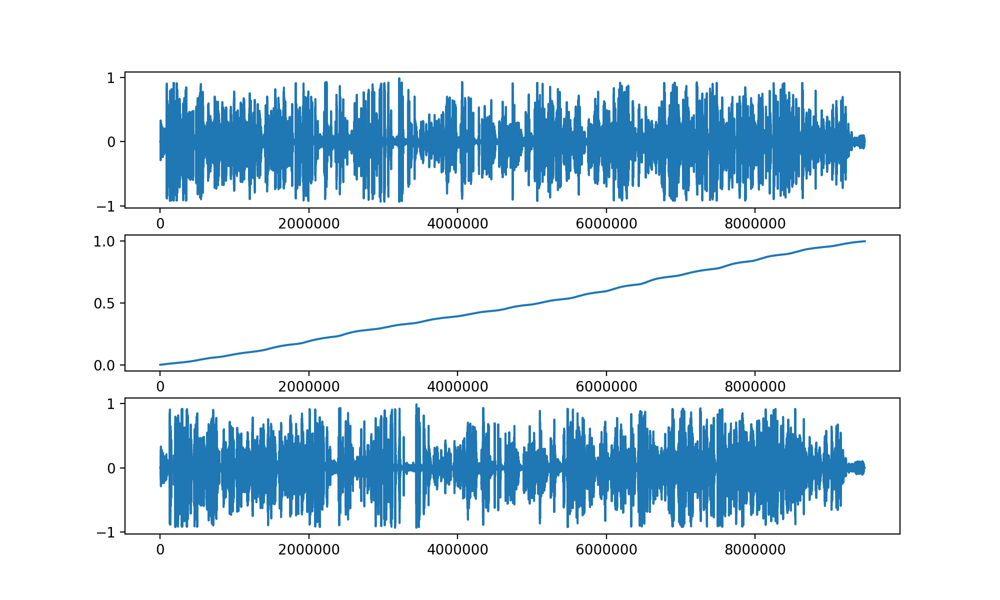

<IPython.core.display.Javascript object>


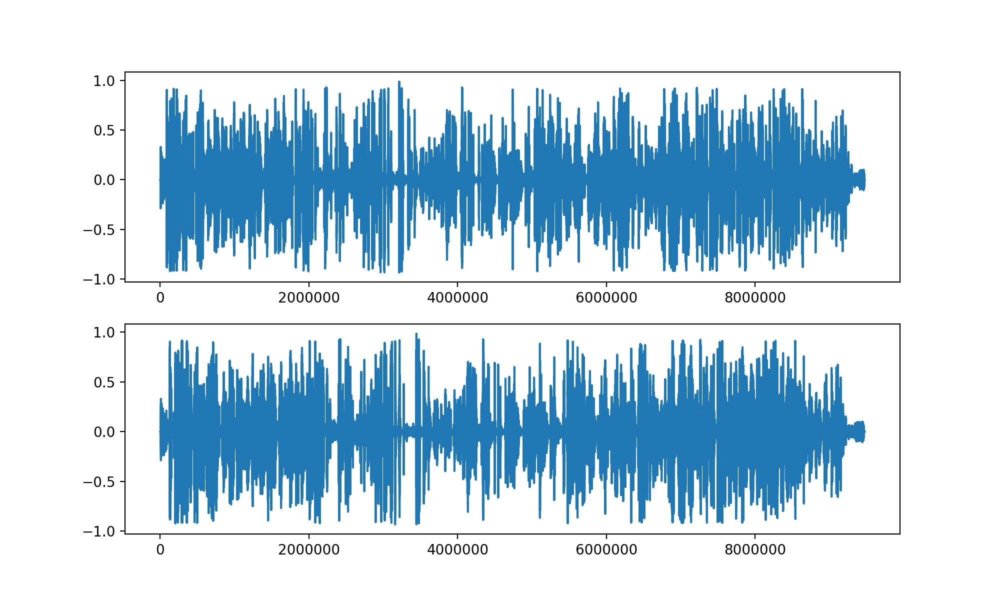

In [9]:
A = extractData()

fs = 44100
bk, sr = librosa.load("bjork.wav", sr=fs)

'''
minF = np.min(Y)
maxF = np.max(Y)

setSize = np.absolute(minF) + np.absolute(maxF)
freqsSize = freqs[1] - freqs[0]
scaleSize = setSize/freqsSize
Y = Y / scaleSize

newminF = np.min(Y)

offsetSize = np.absolute(newminF) + freqs[0]
Y += offsetSize
'''

plt.plot(bk)
plt.title("Bjork Speech")


"""
X    Interpolate the time series you're using to drive the audio to be the length of the audio (which you've done)

X    Make sure the time series is nonnegative and scaled to some appropriate range

X    Integrate the time series

X    Make sure the integrated time series is on the interval [0, 1], and use that to resample the audio
"""




#interpolate A to size of Bjork
fac = len(bk)/len(A)
N = len(A)
x = np.linspace(0, 1, N)
f = interpolate.interp1d(x,A,kind='cubic')
xnew = np.linspace(0, 1, int(fac*N))
S = f(xnew)

#take cumsum of interpolated A
SS = positive_data_scale(S)
SInteg = np.cumsum(SS, axis=0)/fs
scale = SInteg[len(SInteg)-1]
SScale = SInteg / scale

lB = len(bk)
xB = np.linspace(0, 1, lB)
fB = interpolate.interp1d(xB,bk,kind='cubic')
B = fB(SScale)

plt.figure(figsize=(10, 6))
plt.subplot(311)
plt.plot(A)
plt.subplot(312)
plt.plot(xnew)
plt.subplot(313)
plt.plot(S)


plt.figure(figsize=(10,6))
plt.subplot(211)
plt.plot(SInteg)
plt.subplot(212)
plt.plot(SScale)


plt.figure(figsize=(10, 6))
plt.subplot(311)
plt.plot(bk)
plt.subplot(312)
plt.plot(SScale)
plt.subplot(313)
plt.plot(B)

plt.figure(figsize=(10,6))
plt.subplot(211)
plt.plot(bk)
plt.subplot(212)
plt.plot(B)


In [10]:
fs = 44100
ipd.Audio(B, rate=fs)